Professeur MANO Mathew


Eleve BODA Nelson 20190008

# Business Intelligences

In [202]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import folium
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt




### PRACTICE 1

In [203]:
path = '/Users/nelson/Downloads/uber-raw-data-apr14.csv'

In [204]:
df = pd.read_csv(path, delimiter=',')

In [205]:
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [206]:
df.tail()

,Date/Time,Lat,Lon,Base
564511,4/30/2014 23:22:00,40.7640,-73.9744,B02764
564512,4/30/2014 23:26:00,40.7629,-73.9672,B02764
564513,4/30/2014 23:31:00,40.7443,-73.9889,B02764
564514,4/30/2014 23:32:00,40.6756,-73.9405,B02764
564515,4/30/2014 23:48:00,40.6880,-73.9608,B02764


In [207]:
df['Date/Time'] = df['Date/Time'].map(pd.to_datetime)

In [208]:
def get_dom(dt):
    return dt.day

In [209]:
df.describe()

,Lat,Lon
count,564516.000000,564516.000000
mean,40.740005,-73.976817
std,0.036083,0.050426
min,40.072900,-74.773300
25%,40.722500,-73.997700
50%,40.742500,-73.984800
75%,40.760700,-73.970000
max,42.116600,-72.066600


In [210]:
def get_weekday(dt):
    return dt.weekday()

In [211]:
df['weekday']= df['Date/Time'].map(get_weekday)

In [212]:
df.head()

,Date/Time,Lat,Lon,Base,weekday
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,1
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,1
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,1
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,1
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,1


In [213]:
def get_hour(dt):
    return dt.hour

In [214]:
def get_day(dt):
    return dt.day

In [215]:
df['day']= df['Date/Time'].map(get_day)

In [216]:
df['hour']= df['Date/Time'].map(get_hour)

In [217]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,1,1,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,1,1,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,1,1,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,1,1,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,1,1,0


In [218]:
#df = df.drop('hour', axis=1)

In [219]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,1,1,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,1,1,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,1,1,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,1,1,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,1,1,0


Text(0.5, 0, 'Days of the month')

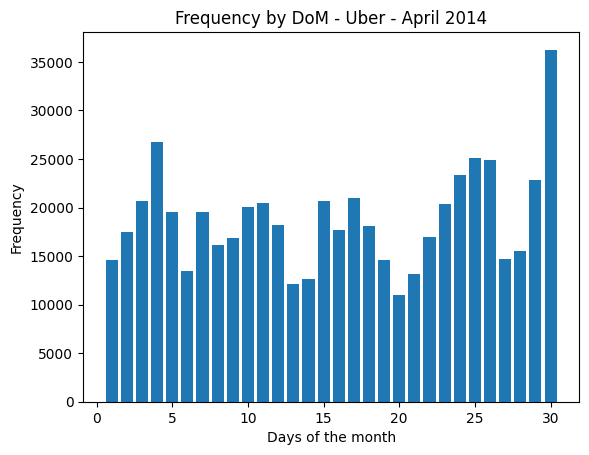

In [220]:
hist = df["day"].plot.hist(bins = 30, rwidth = 0.8, range=(0.5,30.5), title = "Frequency by DoM - Uber - April 2014")
plt.xlabel('Days of the month')
#binsint or sequence or str, default: rcParams["hist.bins"] (default: 10)
#If bins is an integer, it defines the number of equal-width bins in the range.
#If bins is a sequence, it defines the bin edges, including the left edge of the first bin and the right edge of the last bin; in this case, bins may be unequally spaced.

In [221]:
def count_rows(rows):
    return len(rows)

In [222]:
by_date = df.groupby('day').apply(count_rows)
by_date

day
1     14546
2     17474
3     20701
4     26714
5     19521
6     13445
7     19550
8     16188
9     16843
10    20041
11    20420
12    18170
13    12112
14    12674
15    20641
16    17717
17    20973
18    18074
19    14602
20    11017
21    13162
22    16975
23    20346
24    23352
25    25095
26    24925
27    14677
28    15475
29    22835
30    36251
dtype: int64

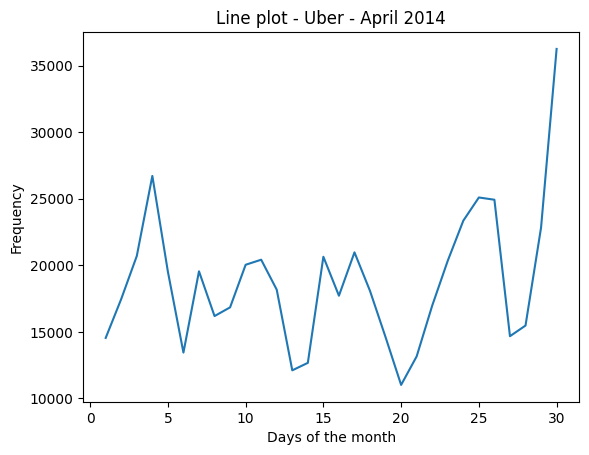

In [223]:
plt.title('Line plot - Uber - April 2014')
plt.xlabel('Days of the month')
plt.ylabel('Frequency')
plt.plot(by_date)

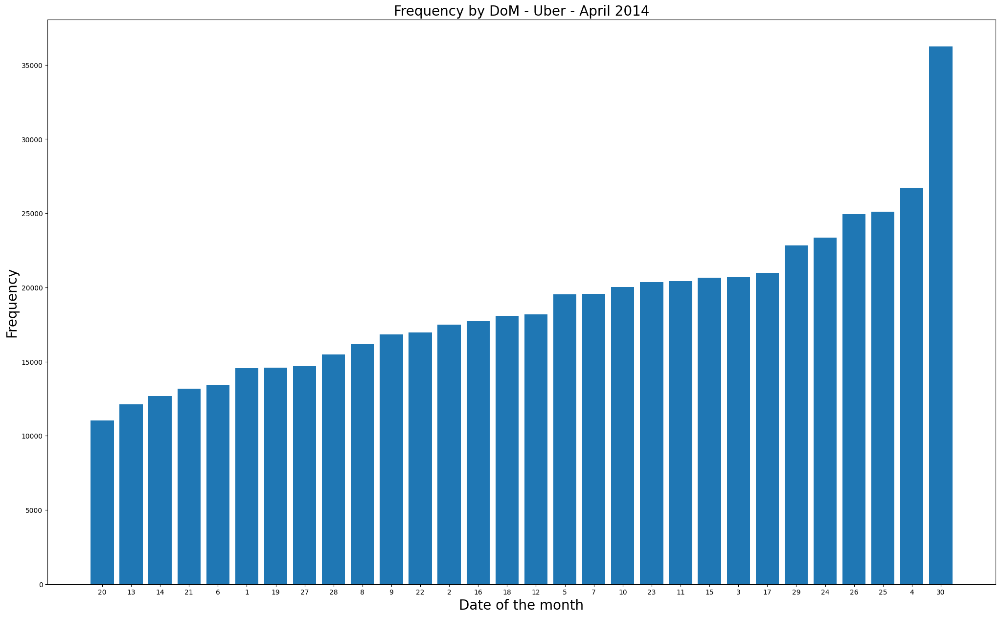

In [224]:
plt.figure(figsize = (25, 15))
plt.bar(range(1, 31), by_date.sort_values())
plt.xticks(range(1, 31), by_date.sort_values().index)
plt.xlabel(('Date of the month'), fontsize=20)
plt.ylabel(('Frequency'), fontsize=20)
plt.title(('Frequency by DoM - Uber - April 2014'), fontsize=20);

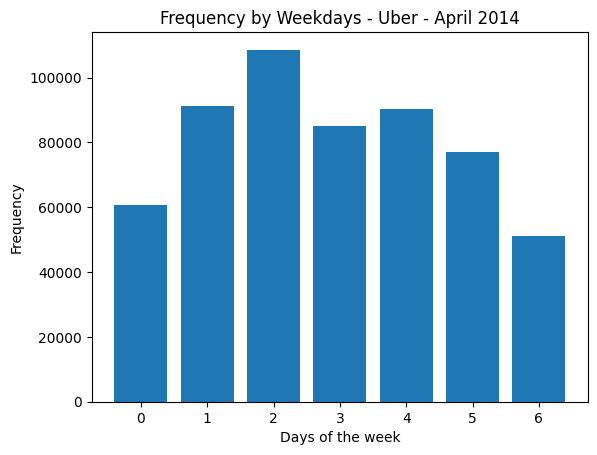

In [225]:
#plt.figure(figsize = (15, 15))
plt.hist(df.weekday, bins = 7, rwidth = 0.8, range = (-.5, 6.5))
plt.xlabel('Days of the week')
plt.ylabel('Frequency')
plt.title('Frequency by Weekdays - Uber - April 2014');

In [226]:
'''Task to do :

Label the x -axis with the days of the week... by Mano Joseph MATHEW
Mano Joseph MATHEW
12:54

Label the x -axis with the days of the week starting from Tuesday '''

'Task to do :\n\nLabel the x -axis with the days of the week... by Mano Joseph MATHEW\nMano Joseph MATHEW\n12:54\n\nLabel the x -axis with the days of the week starting from Tuesday '

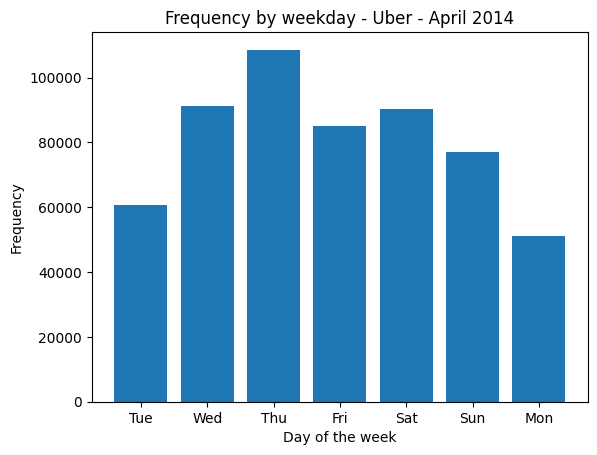

In [227]:
plt.hist(df.weekday, bins = 7, rwidth = 0.8, range = (-.5, 6.5))
plt.xlabel('Day of the week')
plt.ylabel('Frequency')
plt.title('Frequency by weekday - Uber - April 2014')
plt.xticks(np.arange(7), 'Tue Wed Thu Fri Sat Sun Mon'.split())
plt.show()

In [228]:
df.head()

,Date/Time,Lat,Lon,Base,weekday,day,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,1,1,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,1,1,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,1,1,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,1,1,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,1,1,0


In [229]:
df2 = df.groupby(['weekday', 'hour']).apply(count_rows).unstack()
df2.head()
#Pandas Unstack is a function that pivots the level of the indexed columns in a stacked dataframe. A stacked dataframe is usually a result of an aggregated groupby function in pandas. Stack() sets the columns to a new level of hierarchy whereas Unstack() pivots the indexed column.

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
weekday,,,,,,,,,,,,,,,,,,,,,
0,518,261,238,571,1021,1619,2974,3888,3138,2211,...,3117,3818,4962,5574,4725,4386,3573,3079,1976,1091
1,765,367,304,516,887,1734,3766,5304,4594,2962,...,4489,6042,7521,8297,7089,6459,6310,5993,3614,1948
2,899,507,371,585,1003,1990,4230,5647,5242,3846,...,5438,7071,8213,9151,8334,7794,7783,6921,4845,2571
3,792,459,342,567,861,1454,3179,4159,3616,2654,...,4083,5182,6149,6951,6637,5929,6345,6585,5370,2909
4,1367,760,513,736,932,1382,2836,3943,3648,2732,...,4087,5354,6259,6790,7258,6247,5165,6265,6708,5393


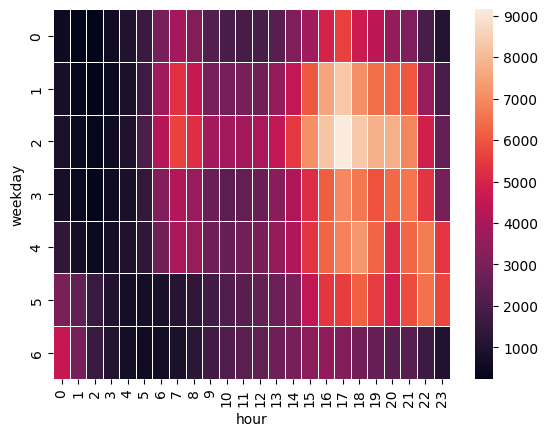

In [230]:
sns.heatmap(df2, linewidths = .5);

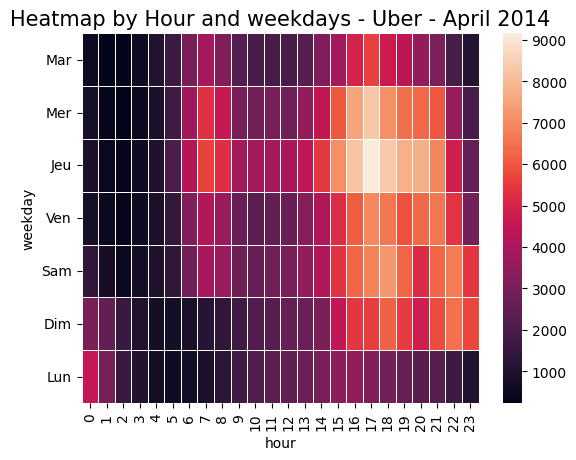

In [231]:
heatmap = sns.heatmap(df2, linewidths = .5);
#Annoted heatmap
plt.title('Heatmap by Hour and weekdays - Uber - April 2014',fontsize=15)
heatmap.set_yticklabels(('Mar Mer Jeu Ven Sam Dim Lun').split(), rotation='horizontal');

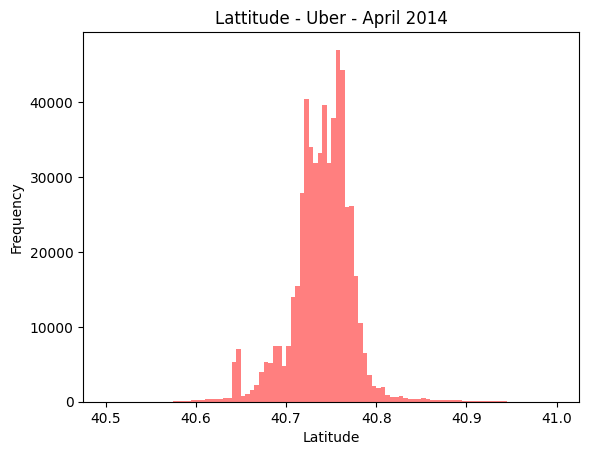

In [232]:
#Lat :
plt.hist(df['Lat'], bins = 100, range = (40.5, 41), color = 'r',alpha = 0.5, label = 'Latitude')
plt.xlabel('Latitude')
plt.ylabel('Frequency')
plt.title('Lattitude - Uber - April 2014');
plt.show()

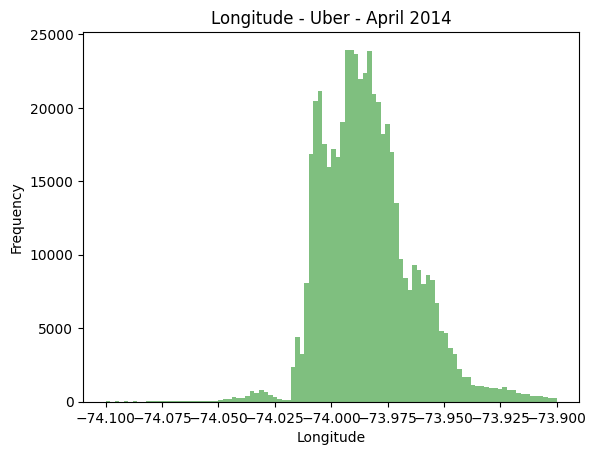

In [233]:
#Lon :
plt.hist(df['Lon'], bins = 100, range = (-74.1, -73.9), color = 'g', alpha = 0.5, label = 'Longitude')
plt.xlabel('Longitude')
plt.ylabel('Frequency')
plt.title('Longitude - Uber - April 2014');
plt.show()

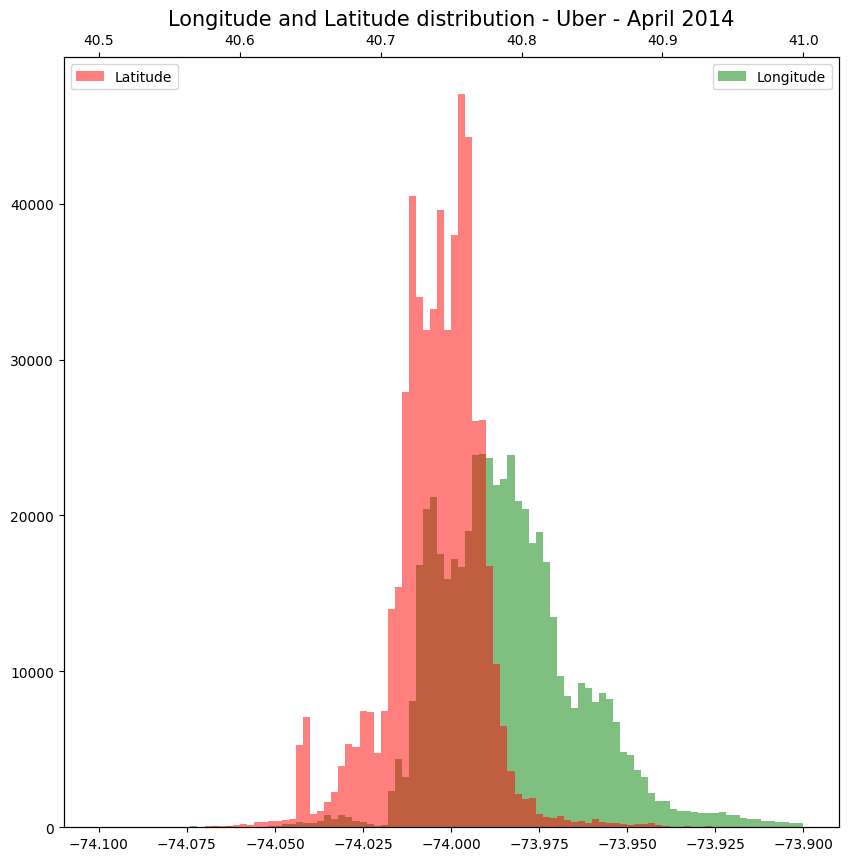

In [234]:
plt.figure(figsize=(10, 10), dpi=100)
plt.title('Longitude and Latitude distribution - Uber - April 2014',fontsize=15)
plt.hist(df['Lon'], bins = 100, range = (-74.1, -73.9), color = 'g', alpha = 0.5, label = 'Longitude')
plt.legend(loc = 'best')
plt.twiny()
plt.hist(df['Lat'], bins = 100, range = (40.5, 41), color = 'r',alpha = 0.5, label = 'Latitude')
plt.legend(loc = 'upper left')
plt.show()

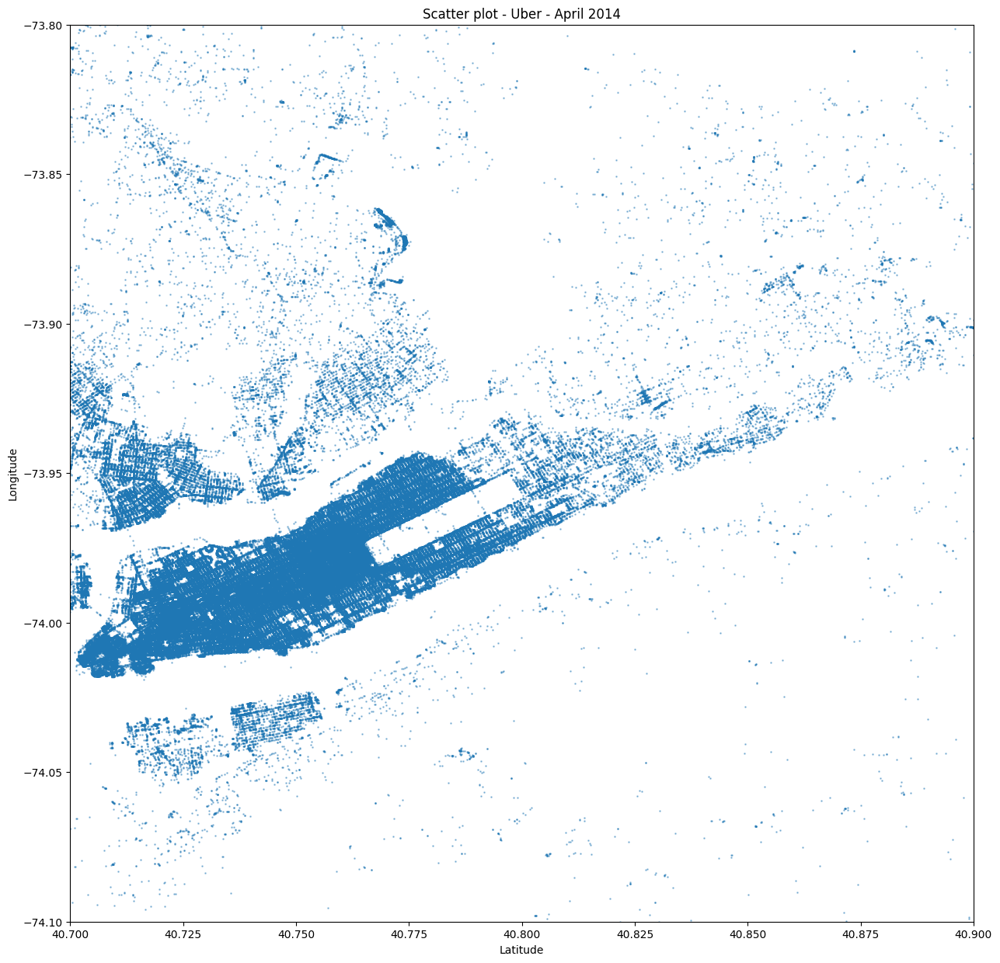

In [235]:
plt.figure(figsize=(15, 15), dpi=100)
plt.title('Scatter plot - Uber - April 2014')
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.scatter(df['Lat'],df['Lon'],s=0.8,alpha=0.4) #Without list also shows the same plot
plt.ylim(-74.1, -73.8)
plt.xlim(40.7, 40.9)
plt.show()

(40.7, 40.9)

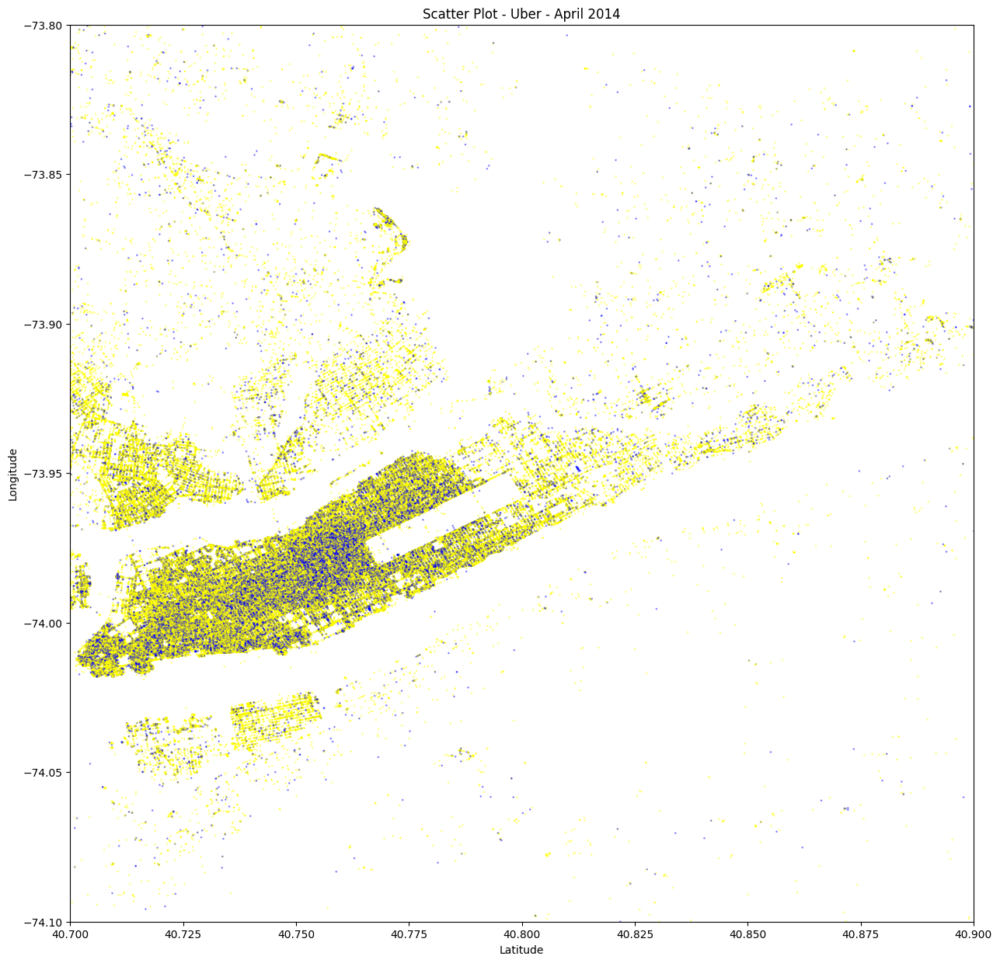

In [236]:
dico = {0:'yellow', 1:'yellow', 2:'blue', 3:'yellow', 4:'yellow', 5:'yellow', 6:'yellow'}
plt.figure(figsize=(15, 15), dpi = 100)
plt.title('Scatter Plot - Uber - April 2014')
x = df["Lat"]
y = df["Lon"]
plt.xlabel('Latitude')
plt.ylabel('Longitude')
plt.scatter(x, y, s = 0.7, alpha = 0.4, c = df["weekday"].map(dico))
plt.ylim(-74.1, -73.8)
plt.xlim(40.7, 40.9)

In [237]:
import pydeck as pdk

DATA_URL = "https://raw.githubusercontent.com/visgl/deck.gl-data/master/examples/geojson/vancouver-blocks.json"
LAND_COVER = [[[-123.0, 49.196], [-123.0, 49.324], [-123.306, 49.324], [-123.306, 49.196]]]
INITIAL_VIEW_STATE = pdk.ViewState(latitude=49.254, longitude=-123.13, zoom=11, max_zoom=16, pitch=45, bearing=0)
polygon = pdk.Layer("PolygonLayer",LAND_COVER,stroked=False,# processes the data as a flat longitude-latitude pair 
                    get_polygon="-",get_fill_color=[0, 0, 0, 20],
)
geojson = pdk.Layer("GeoJsonLayer",DATA_URL,opacity=0.8,stroked=False,filled=True,extruded=True,wireframe=True,get_elevation="properties.valuePerSqm / 20",get_fill_color="[255, 255, properties.growth * 255]",get_line_color=[255, 255, 255],
)
r = pdk.Deck(layers=[polygon, geojson], initial_view_state=INITIAL_VIEW_STATE)
r.to_html("geojson_layer.html")


### PRACTICE 2

Le fichier de données au format CSV à l'URL donnée contient des informations sur les voyages en taxi à New York City. Les données ont été collectées par la Commission des taxis et des limousines de la ville de New York, et couvrent les voyages effectués de janvier à juin 2015.

Le fichier contient les informations suivantes pour chaque voyage en taxi :

pickup_datetime: date et heure de début du voyage.

dropoff_datetime: date et heure de fin du voyage.

passenger_count: nombre de passagers dans le taxi.

trip_distance: distance du voyage en miles.

pickup_longitude: longitude de l'emplacement de prise en charge.

pickup_latitude: latitude de l'emplacement de prise en charge.

dropoff_longitude: longitude de l'emplacement de dépôt.

dropoff_latitude: latitude de l'emplacement de dépôt.

fare_amount: montant de la course, en dollars.

tip_amount: montant du pourboire, en dollars.

total_amount: montant total facturé au client, en dollars.

In [ ]:
url = "https://raw.githubusercontent.com/uber-web/kepler.gl-data/master/nyctrips/data.csv"
df_taxi = pd.read_csv(url, delimiter = ',')
df_taxi.head()


Description des données

In [ ]:
df_taxi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97986 entries, 0 to 97985
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   VendorID               97986 non-null  int64  
 1   tpep_pickup_datetime   97986 non-null  object 
 2   tpep_dropoff_datetime  97986 non-null  object 
 3   passenger_count        97986 non-null  int64  
 4   trip_distance          97986 non-null  float64
 5   pickup_longitude       97986 non-null  float64
 6   pickup_latitude        97986 non-null  float64
 7   dropoff_longitude      97986 non-null  float64
 8   dropoff_latitude       97986 non-null  float64
 9   fare_amount            97986 non-null  float64
 10  tip_amount             97986 non-null  float64
 11  total_amount           97986 non-null  float64
dtypes: float64(8), int64(2), object(2)
memory usage: 9.0+ MB


Recuperer les colonnnes pertinentes :

In [ ]:
columns = ['VendorID', 'tpep_pickup_datetime', 'tpep_dropoff_datetime', 'passenger_count', 'trip_distance', 'fare_amount', 'tip_amount', 'total_amount']
df_taxi_analyse = df_taxi[columns]
df_taxi_analyse.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,fare_amount,tip_amount,total_amount
0,2,2015-01-15 19:05:39 +00:00,2015-01-15 19:23:42 +00:00,1,1.59,12.0,3.25,17.05
1,2,2015-01-15 19:05:39 +00:00,2015-01-15 19:32:00 +00:00,1,2.38,16.5,4.38,22.68
2,2,2015-01-15 19:05:40 +00:00,2015-01-15 19:21:00 +00:00,5,2.83,12.5,0.00,14.30
3,2,2015-01-15 19:05:40 +00:00,2015-01-15 19:28:18 +00:00,5,8.33,26.0,8.08,41.21
4,2,2015-01-15 19:05:41 +00:00,2015-01-15 19:20:36 +00:00,1,2.37,11.5,0.00,13.30


In [ ]:
df_taxi_analyse['tpep_pickup_datetime'] = pd.to_datetime(df_taxi_analyse['tpep_pickup_datetime'])
df_taxi_analyse['tpep_dropoff_datetime'] = pd.to_datetime(df_taxi_analyse['tpep_dropoff_datetime'])

/var/folders/d_/lhs84_vd4pn1715g7dlkm4mm0000gn/T/ipykernel_66723/971911501.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_taxi_analyse['tpep_pickup_datetime'] = pd.to_datetime(df_taxi_analyse['tpep_pickup_datetime'])
/var/folders/d_/lhs84_vd4pn1715g7dlkm4mm0000gn/T/ipykernel_66723/971911501.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_taxi_analyse['tpep_dropoff_datetime'] = pd.to_datetime(df_taxi_analyse['tpep_dropoff_datetime'])


In [ ]:
df_selected_vendor1 = df_taxi_analyse[df_taxi_analyse['VendorID'] == 1]
df_selected_vendor2 = df_taxi_analyse[df_taxi_analyse['VendorID'] == 2]

In [ ]:
#Compagnie 1
df_selected_vendor1.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,fare_amount,tip_amount,total_amount
43,1,2015-01-15 10:26:13+00:00,2015-01-15 10:30:49+00:00,1,0.8,5.5,1.00,7.30
44,1,2015-01-15 10:26:14+00:00,2015-01-15 10:42:16+00:00,1,1.9,12.5,0.00,13.30
45,1,2015-01-15 10:26:14+00:00,2015-01-15 10:51:03+00:00,1,2.6,16.0,3.35,20.15
46,1,2015-01-15 10:26:14+00:00,2015-01-15 10:38:13+00:00,1,0.8,8.5,1.85,11.15
47,1,2015-01-15 10:26:14+00:00,2015-01-15 10:49:00+00:00,2,6.8,23.0,4.50,28.30


In [ ]:
#Compagnie 2
df_selected_vendor2.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,fare_amount,tip_amount,total_amount
0,2,2015-01-15 19:05:39+00:00,2015-01-15 19:23:42+00:00,1,1.59,12.0,3.25,17.05
1,2,2015-01-15 19:05:39+00:00,2015-01-15 19:32:00+00:00,1,2.38,16.5,4.38,22.68
2,2,2015-01-15 19:05:40+00:00,2015-01-15 19:21:00+00:00,5,2.83,12.5,0.00,14.30
3,2,2015-01-15 19:05:40+00:00,2015-01-15 19:28:18+00:00,5,8.33,26.0,8.08,41.21
4,2,2015-01-15 19:05:41+00:00,2015-01-15 19:20:36+00:00,1,2.37,11.5,0.00,13.30


Comparaison des points de retrait et point de dépot

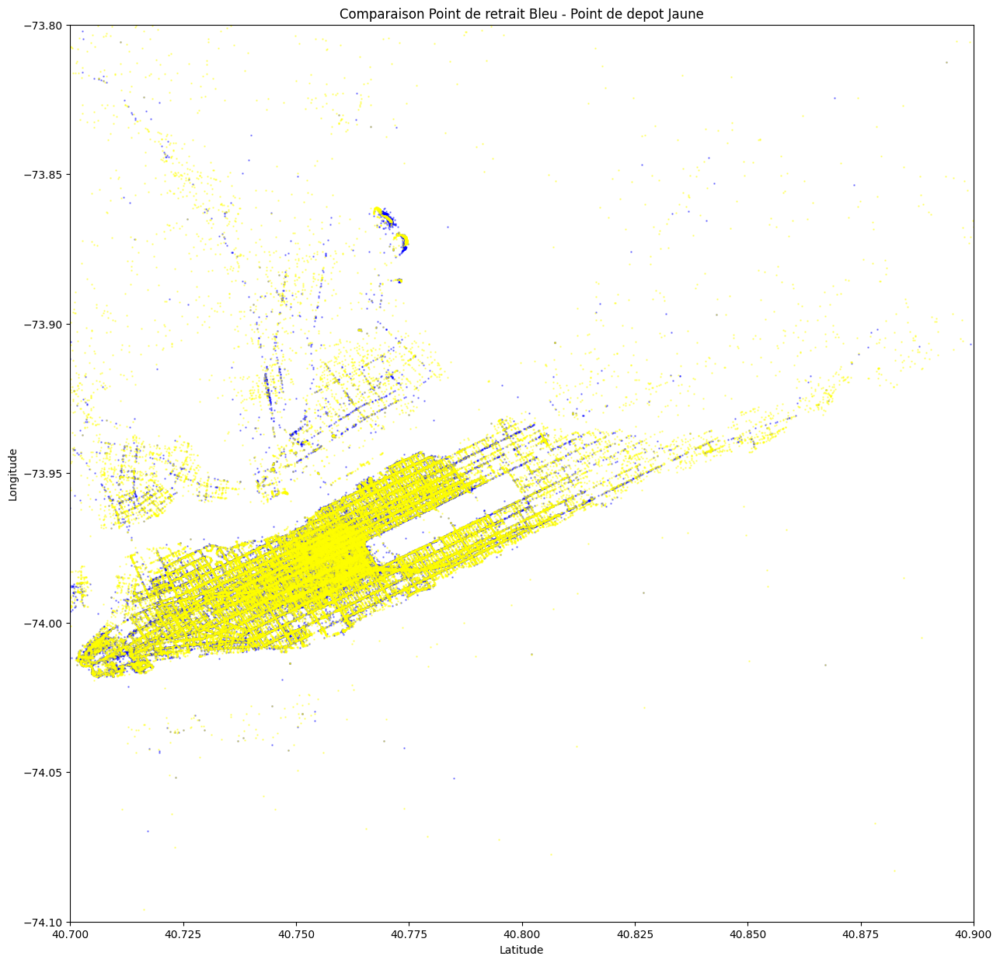

In [ ]:
col_long_lat = ['VendorID','pickup_longitude','pickup_latitude','dropoff_longitude','dropoff_latitude']
df_taxi_long_lat = df_taxi[col_long_lat]
df_taxi_long_lat.head()

fig, ax = plt.subplots(figsize=(15, 15))

#Titre
ax.set_title('Comparaison Point de retrait Bleu - Point de depot Jaune')

# Définir les données pour les axes X et Y
pickup_x = df_taxi_long_lat['pickup_latitude']
pickup_y = df_taxi_long_lat['pickup_longitude']
dropoff_x = df_taxi_long_lat['dropoff_latitude']
dropoff_y = df_taxi_long_lat['dropoff_longitude']

# Afficher les données sous forme de nuage de points
ax.scatter(pickup_x, pickup_y, s=0.7, alpha=0.4, c='blue')
ax.scatter(dropoff_x, dropoff_y, s=0.7, alpha=0.4, c='yellow')

# Définir les limites de l'axe X et Y
ax.set_xlim((40.7, 40.9))
ax.set_ylim((-74.1, -73.8))

# Définir les étiquettes de l'axe X et Y
ax.set_xlabel('Latitude')
ax.set_ylabel('Longitude')

# Afficher le graphique
plt.show()

# Sélectionner les colonnes pertinentes

## Compagnie 1

resultat : en moyenne la compagnie 1 parcours 13 minutes et 14 Secondes par trajets


In [ ]:
columns_dep_retr = ['VendorID', 'tpep_pickup_datetime', 'tpep_dropoff_datetime']

# Selectionne uniquement la compagnie 1
df_selected_1 = df_taxi.loc[df_taxi['VendorID'] == 1, columns_dep_retr]
df_selected_1.head()

# Calculer la différence entre la colonne 'tpep_dropoff_datetime' et 'tpep_pickup_datetime' de la compagnie 1
df_selected_1['duration'] = pd.to_datetime(df_selected_1['tpep_dropoff_datetime']) - pd.to_datetime(df_selected_1['tpep_pickup_datetime'])

# Calculer la moyenne de la durée des courses
mean_duration_vendor1 = df_selected_1['duration'].mean()

# Afficher la moyenne
print(mean_duration_vendor1)

0 days 00:13:14.151786322


## Compagnie 2

En moyenne la compagnie 2 parcours 14 minutes et 52 Secondes par trajets

In [ ]:
df_selected_2 = df_taxi.loc[df_taxi['VendorID'] == 2, columns_dep_retr]
df_selected_2.head()

# Calculer la différence entre la colonne 'tpep_dropoff_datetime' et 'tpep_pickup_datetime' de la compagnie 1
df_selected_2['duration'] = pd.to_datetime(df_selected_2['tpep_dropoff_datetime']) - pd.to_datetime(df_selected_2['tpep_pickup_datetime'])

# Calculer la moyenne de la durée des courses
mean_duration_vendor2 = df_selected_2['duration'].mean()

# Afficher la moyenne
print(mean_duration_vendor2)

0 days 00:14:52.602998684


In [ ]:
def split_duration(arg):
    mean_duration_seconds = arg.total_seconds()
    
    hours = int(mean_duration_seconds // 3600)

    mean_duration_seconds %= 3600

    minutes = int(mean_duration_seconds // 60)

    seconds = int(mean_duration_seconds % 60)

    print(f"Heure : {hours:02}, Minutes : {minutes:02}, Seconde : {seconds:02}")


print("Temps moyens de trajet pour la compagnie 1" ,split_duration(mean_duration_vendor1))
print("Temps moyens de trajet pour la compagnie 2" ,split_duration(mean_duration_vendor2))

Heure : 00, Minutes : 13, Seconde : 14
Temps moyens de trajet pour la compagnie 1 None
Heure : 00, Minutes : 14, Seconde : 52
Temps moyens de trajet pour la compagnie 2 None


# Horaires 

## Compagnie 1

Ci dessous le nombre de course en fonction de l'heure et minute de prise en charge



/var/folders/d_/lhs84_vd4pn1715g7dlkm4mm0000gn/T/ipykernel_66723/1668256903.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_taxi['tpep_pickup_datetime'] = pd.to_datetime(df_taxi['tpep_pickup_datetime'])
/var/folders/d_/lhs84_vd4pn1715g7dlkm4mm0000gn/T/ipykernel_66723/1668256903.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_taxi['hour'] = df_taxi['tpep_pickup_datetime'].dt.hour
/var/folders/d_/lhs84_vd4pn1715g7dlkm4mm0000gn/T/ipykernel_66723/1668256903.py:8: SettingWithCopyWarning: 
A value i

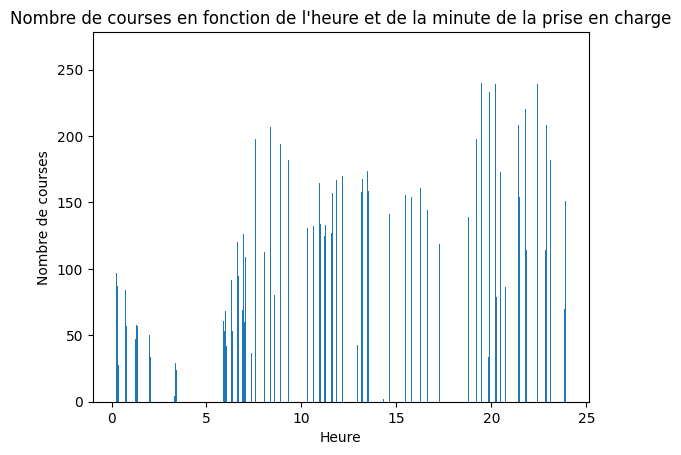

In [ ]:
df_taxi_1 = df_taxi.loc[df_taxi['VendorID'] == 1]

def get_pickup_hours(arg):
    df_taxi = arg
    df_taxi['tpep_pickup_datetime'] = pd.to_datetime(df_taxi['tpep_pickup_datetime'])

    df_taxi['hour'] = df_taxi['tpep_pickup_datetime'].dt.hour
    df_taxi['minute'] = df_taxi['tpep_pickup_datetime'].dt.minute

    df_count = df_taxi.groupby(['hour', 'minute']).size().reset_index(name='count')

    plt.bar(df_count['hour'] + df_count['minute'] / 60, df_count['count'], width=0.01)
    plt.xlabel('Heure')
    plt.ylabel('Nombre de courses')
    plt.title('Nombre de courses en fonction de l\'heure et de la minute de la prise en charge')
    plt.show()

get_pickup_hours(df_taxi_1)

# Compagnie 2

/var/folders/d_/lhs84_vd4pn1715g7dlkm4mm0000gn/T/ipykernel_66723/1668256903.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_taxi['tpep_pickup_datetime'] = pd.to_datetime(df_taxi['tpep_pickup_datetime'])
/var/folders/d_/lhs84_vd4pn1715g7dlkm4mm0000gn/T/ipykernel_66723/1668256903.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_taxi['hour'] = df_taxi['tpep_pickup_datetime'].dt.hour
/var/folders/d_/lhs84_vd4pn1715g7dlkm4mm0000gn/T/ipykernel_66723/1668256903.py:8: SettingWithCopyWarning: 
A value i

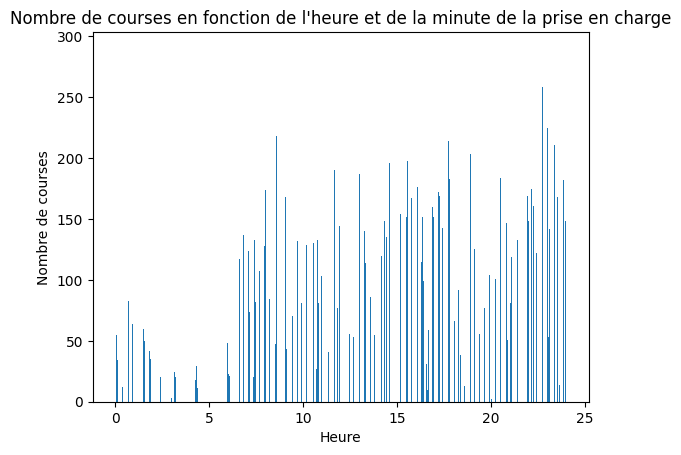

In [ ]:
df_taxi_2 = df_taxi.loc[df_taxi['VendorID'] == 2]
get_pickup_hours(df_taxi_2)

Fréquence de passager en fonction de l'heure de prise en charge pour les 2 compagnie.

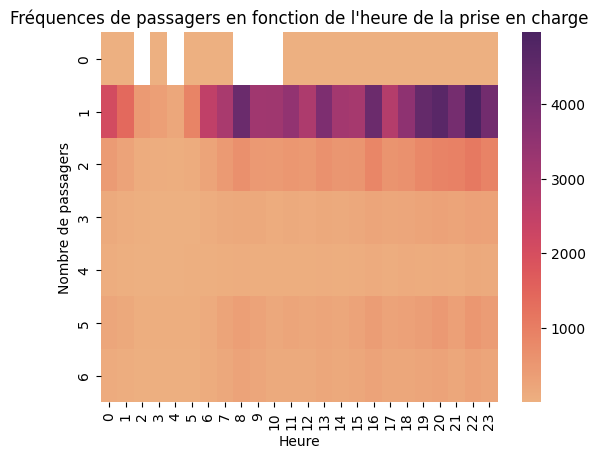

In [ ]:

columns = ['tpep_pickup_datetime', 'passenger_count']
df_taxi['tpep_pickup_datetime'] = pd.to_datetime(df_taxi['tpep_pickup_datetime'])
df_taxi['hour'] = df_taxi['tpep_pickup_datetime'].dt.hour
df_count = df_taxi.groupby(['hour', 'passenger_count']).size().reset_index(name='count')
df_pivot = df_count.pivot(index='passenger_count', columns='hour', values='count')
sns.heatmap(df_pivot, cmap='flare')
plt.title('Fréquences de passagers en fonction de l\'heure de la prise en charge')
plt.xlabel('Heure')
plt.ylabel('Nombre de passagers')
plt.show()


## Prise en charge
Nombre de prise en charge par emplacement

In [ ]:
#Je reinitialise le dataset
url = "https://raw.githubusercontent.com/uber-web/kepler.gl-data/master/nyctrips/data.csv"
df_taxi = pd.read_csv(url, delimiter = ',')

# Supprimer les lignes contenant des valeurs non valides pour la colonne 'pickup_latitude'
df_taxi.dropna(subset=['pickup_latitude'], inplace=True)

# Créer une carte centrée sur New York
m = folium.Map(location=[40.75, -73.95], zoom_start=12, tiles='Stamen Terrain')

# Créer un groupe de marqueurs pour les coordonnées de prise en charge
marker_cluster = MarkerCluster().add_to(m)

# Ajouter un marqueur pour chaque coordonnée de prise en charge
for index, row in df_taxi.iterrows():
    pickup_latitude = row['pickup_latitude']
    pickup_longitude = row['pickup_longitude']
    marker = folium.Marker(location=[pickup_latitude, pickup_longitude])
    marker_cluster.add_child(marker)

# Afficher la carte
m



## Tarif

Modele de regression logistique pour determiné la probalité qu'un client donne un pourboire lors d'un trajet

In [ ]:
# Charger les données depuis le fichier CSV
url = 'https://raw.githubusercontent.com/uber-web/kepler.gl-data/master/nyctrips/data.csv'
df_taxi = pd.read_csv(url)

# Créer un DataFrame avec les variables d'intérêt pour la régression logistique
df = df_taxi[['fare_amount', 'tip_amount', 'total_amount', 'tip_amount > 0']]

# Renommer la variable binaire 'tip_amount > 0' en 'tip_given'
df = df.rename(columns={'tip_amount > 0': 'tip_given'})

# Convertir la variable 'tip_given' en 0 et 1
df['tip_given'] = df['tip_given'].astype(int)

# Transformer la variable 'tip_amount' pour réduire le biais
df['tip_amount'] = np.log(df['tip_amount'] + 1)

# Ne conserver que la variable 'fare_amount' pour éviter la corrélation avec 'total_amount'
df = df[['fare_amount', 'tip_amount', 'tip_given']]

# Diviser les données en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(df[['fare_amount', 'tip_amount']], df['tip_given'], test_size=0.3, random_state=0)

# Créer un modèle de régression logistique
model = LogisticRegression()

# Entraîner le modèle sur l'ensemble d'entraînement
model.fit(X_train, y_train)

# Calculer la précision du modèle sur l'ensemble de test
accuracy = model.score(X_test, y_test)

# Créer un graphique à barres pour afficher la précision du modèle
plt.bar(['Précision'], [accuracy])
plt.ylim(0, 1)
plt.title('Performance du modèle de régression logistique')
plt.ylabel('Précision')
plt.show()

KeyError: "['tip_amount > 0'] not in index"

## Frequence de Depot par emplacement
Fréquence de lattitude et de longitude ou il y'a le plus de personne deposer lors d'une course

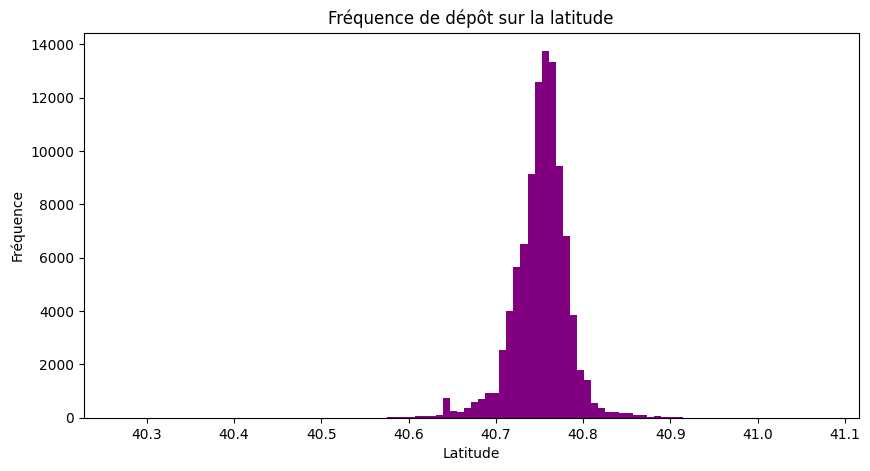

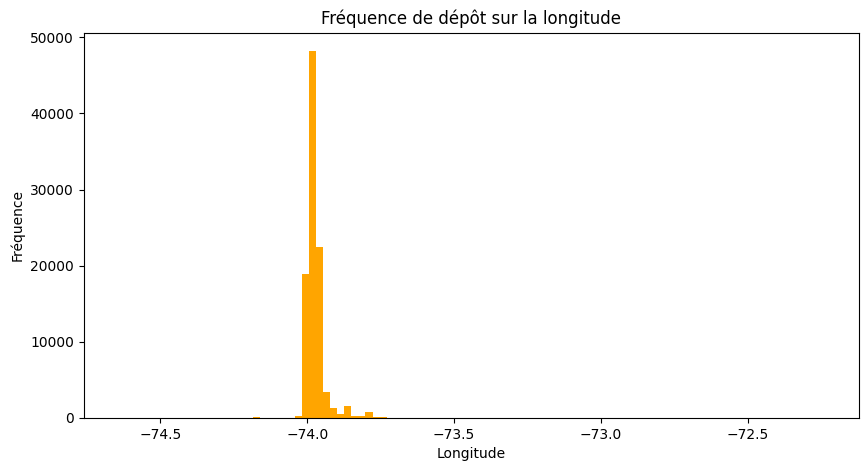

In [ ]:
# Ont reinitialise les données
url = 'https://raw.githubusercontent.com/uber-web/kepler.gl-data/master/nyctrips/data.csv'
df_taxi = pd.read_csv(url)

# Extraire les variables d'intérêt pour l'histogramme
lat = df_taxi['dropoff_latitude']
long = df_taxi['dropoff_longitude']

# Créer un graphique en barres de la fréquence de dépôt sur la latitude
fig2, ax2 = plt.subplots(figsize=(10, 5))
ax2.hist(lat, bins=100, color='purple')
ax2.set_xlabel('Latitude')
ax2.set_ylabel('Fréquence')
ax2.set_title('Fréquence de dépôt sur la latitude')

# Créer un graphique en barres de la fréquence de dépôt sur la longitude
fig3, ax3 = plt.subplots(figsize=(10, 5))
ax3.hist(long, bins=100, color='orange')
ax3.set_xlabel('Longitude')
ax3.set_ylabel('Fréquence')
ax3.set_title('Fréquence de dépôt sur la longitude')

plt.show()


## Trajet rentable
Représentation graphique sur une map ou les courses sont le plus chers.

In [ ]:

# Charger les données depuis le fichier CSV
url = 'https://raw.githubusercontent.com/uber-web/kepler.gl-data/master/nyctrips/data.csv'
df_taxi = pd.read_csv(url)

# Extraire les variables d'intérêt pour la carte
lat = df_taxi['pickup_latitude']
long = df_taxi['pickup_longitude']
price = df_taxi['total_amount']
distance = df_taxi['trip_distance']

# Créer un DataFrame contenant les informations nécessaires pour la carte
df_map = pd.DataFrame({'Latitude': lat,
                       'Longitude': long,
                       'Total Amount': price,
                       'Trip Distance': distance})

# Filtrer les données pour les trajets les plus chers
df_map = df_map[df_map['Total Amount'] > 50]

# Créer un heatmap de la fréquence de trajet les plus chers par distance de trajet
map_heat = folium.Map(location=[40.75, -73.98], zoom_start=10, control_scale=True)
hm = HeatMap(data=df_map[['Latitude', 'Longitude', 'Trip Distance']].values.tolist(), 
             name='Frequence de trajet les plus chers',
             min_opacity=0.1, 
             radius=10, 
             blur=5, 
             max_zoom=10, 
             control=True,
             overlay=True)

# Ajouter le heatmap à la carte
hm.add_to(map_heat)

# Afficher la carte
map_heat
